In [1]:
import pathlib
import gdown
import zipfile
import os

import pandas as pd
import pathlib
from pathlib import Path
import imagehash

import numpy as np
import pandas as pd

# plotting modules
from matplotlib import pyplot as plt
import seaborn as sns

import plotly as plotly
plotly.offline.init_notebook_mode()
from PIL import Image

## Getting the Dataset

In [ ]:
# Replace with your Google Drive file ID
file_id = '1uIG47BrIJ1XH9wn8JmIoRPt9e-WFzNV3'
url = f'https://drive.google.com/uc?id={file_id}'

# Replace with your desired output file name
output = 'data_plant_disease.zip'

In [ ]:
# Check if the file has already been downloaded
if not os.path.exists(output):
    print(f"Downloading {output} from Google Drive...")
    gdown.download(url, output, quiet=False)
else:
    print(f"{output} already exists. Skipping download.")

In [ ]:
# Define the path where you want to extract the files
extract_to = 'dataset'

# Check if the extraction folder already exists
if not os.path.exists(extract_to):
    print(f"Extracting {output}...")
    with zipfile.ZipFile(output, 'r') as zip_ref:
        zip_ref.extractall(extract_to)
    print(f"Extraction completed. Files are now in {extract_to}.")
else:
    print(f"Files already extracted to {extract_to}. Skipping extraction.")


In [ ]:
data_path = './dataset/plant-disease'
data_folder = pathlib.Path(data_path)

In [2]:
data_folder = pathlib.Path('../../../../../Downloads/datasets/plant-disease')

## Create Image Dataframe

In [3]:
def create_image_dataframe(folder):
    data = {'ImagePath': [], 'ClassLabel': [], 'ImageName': [], 'ImagePhash': []}
    
    for class_folder in Path(folder).iterdir():
        if class_folder.is_dir():
            for img_path in class_folder.iterdir():
                img_name = img_path.name
                try:
                    img = Image.open(img_path)
                    img_phash = str(imagehash.phash(img))
                except Exception as e:
                    img_phash = None

                data['ImagePath'].append(img_path)
                data['ClassLabel'].append(class_folder.name)
                data['ImageName'].append(img_name)
                data['ImagePhash'].append(img_phash)
    
    return pd.DataFrame(data)

In [4]:
df = create_image_dataframe(data_folder)

Here we have also derived the perceptual hash for each image in our dataset.

In [5]:
df

,ImagePath,ClassLabel,ImageName,ImagePhash
0,..\..\..\..\..\Downloads\datasets\plant-diseas...,algal leaf in tea,algal_leaf_in_tea1.jpg,a1a69e91646e9bb1
1,..\..\..\..\..\Downloads\datasets\plant-diseas...,algal leaf in tea,algal_leaf_in_tea10.jpg,b19c9761cb169d83
2,..\..\..\..\..\Downloads\datasets\plant-diseas...,algal leaf in tea,algal_leaf_in_tea100.jpg,f4c3cb3c38a2628f
3,..\..\..\..\..\Downloads\datasets\plant-diseas...,algal leaf in tea,algal_leaf_in_tea101.jpg,b190c36d9ce64c3e
4,..\..\..\..\..\Downloads\datasets\plant-diseas...,algal leaf in tea,algal_leaf_in_tea101.jpg_Flip_Horizontally_and...,e436c2c99ebcc839
...,...,...,...,...
128077,..\..\..\..\..\Downloads\datasets\plant-diseas...,Tomato Tomato mosaic virus,tomato_tomato_mosaic_virus978.jpg,f8e2c69c999323c3
128078,..\..\..\..\..\Downloads\datasets\plant-diseas...,Tomato Tomato mosaic virus,tomato_tomato_mosaic_virus979.jpg,a436d66b3c946999
128079,..\..\..\..\..\Downloads\datasets\plant-diseas...,Tomato Tomato mosaic virus,Tomato_Tomato_mosaic_virus98.jpg,fcb0c3cc8cc63639
128080,..\..\..\..\..\Downloads\datasets\plant-diseas...,Tomato Tomato mosaic virus,tomato_tomato_mosaic_virus980.jpg,f19c83c1693e3c33


We store this to a csv file

In [6]:
#save the dataframe to a csv file
df.to_csv('plant_id_with_phash.csv', index=False)


In [7]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 128082 entries, 0 to 128081
Data columns (total 4 columns):
 #   Column      Non-Null Count   Dtype 
---  ------      --------------   ----- 
 0   ImagePath   128082 non-null  object
 1   ClassLabel  128082 non-null  object
 2   ImageName   128082 non-null  object
 3   ImagePhash  128082 non-null  object
dtypes: object(4)
memory usage: 3.9+ MB


In [8]:
df.describe()

,ImagePath,ClassLabel,ImageName,ImagePhash
count,128082,128082,128082,128082
unique,128082,43,128082,111977
top,..\..\..\..\..\Downloads\datasets\plant-diseas...,Grape Esca Black Measles,algal_leaf_in_tea1.jpg,e664ccce99989b19
freq,1,13284,1,3


In [9]:
df['ClassLabel'].value_counts()

ClassLabel
Grape Esca Black Measles                       13284
Grape Black rot                                11328
Grape Leaf blight Isariopsis Leaf Spot         10332
Tomato Bacterial spot                           6381
Apple Apple scab                                6048
Apple Black rot                                 5964
Tomato Late blight                              5727
Tomato Septoria leaf spot                       5313
Tomato Spider mites Two spotted spider mite     5028
Tomato Target Spot                              4212
Apple healthy                                   3948
Common Rust in corn Leaf                        3918
Tomato healthy                                  3819
Pepper bell healthy                             3549
Blight in corn Leaf                             3438
Potato Early blight                             3000
Potato Late blight                              3000
Tomato Early blight                             3000
Pepper bell Bacterial spot         

In [10]:
label_group = df.groupby('ClassLabel').size().reset_index(name='Count')
label_group

,ClassLabel,Count
0,Apple Apple scab,6048
1,Apple Black rot,5964
2,Apple Cedar apple rust,2640
3,Apple healthy,3948
4,Bacterial leaf blight in rice leaf,120
5,Blight in corn Leaf,3438
6,Brown spot in rice leaf,120
7,Cherry (including sour) Powdery mildew,2526
8,Cherry (including_sour) healthy,2052
9,Common Rust in corn Leaf,3918


C:\Users\Owner\AppData\Local\Temp\ipykernel_46632\4255381282.py:8: UserWarning:

set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.



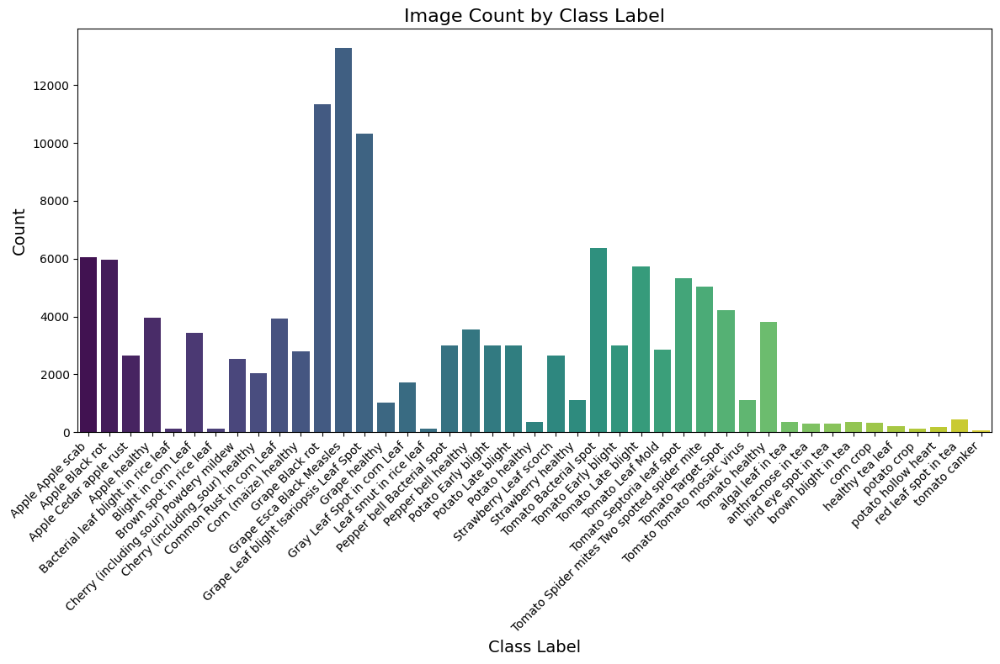

In [11]:
plt.figure(figsize=(12, 8))
bar_plot = sns.barplot(x='ClassLabel', y='Count', data=label_group, palette='viridis', hue='ClassLabel')
plt.title('Image Count by Class Label', fontsize=16)
plt.xlabel('Class Label', fontsize=14)
plt.ylabel('Count', fontsize=14)

# Rotate x labels for better readability
bar_plot.set_xticklabels(bar_plot.get_xticklabels(), rotation=45, horizontalalignment='right')

# Improve layout
plt.tight_layout()

# Show the plot
plt.show()

In [12]:
# get only the first 50 rows from each class
mini_df = df.groupby('ClassLabel').head(50).reset_index(drop=True)
mini_df

,ImagePath,ClassLabel,ImageName,ImagePhash
0,..\..\..\..\..\Downloads\datasets\plant-diseas...,algal leaf in tea,algal_leaf_in_tea1.jpg,a1a69e91646e9bb1
1,..\..\..\..\..\Downloads\datasets\plant-diseas...,algal leaf in tea,algal_leaf_in_tea10.jpg,b19c9761cb169d83
2,..\..\..\..\..\Downloads\datasets\plant-diseas...,algal leaf in tea,algal_leaf_in_tea100.jpg,f4c3cb3c38a2628f
3,..\..\..\..\..\Downloads\datasets\plant-diseas...,algal leaf in tea,algal_leaf_in_tea101.jpg,b190c36d9ce64c3e
4,..\..\..\..\..\Downloads\datasets\plant-diseas...,algal leaf in tea,algal_leaf_in_tea101.jpg_Flip_Horizontally_and...,e436c2c99ebcc839
...,...,...,...,...
2145,..\..\..\..\..\Downloads\datasets\plant-diseas...,Tomato Tomato mosaic virus,Tomato_Tomato_mosaic_virus1038.jpg,e39c9c336bcd3124
2146,..\..\..\..\..\Downloads\datasets\plant-diseas...,Tomato Tomato mosaic virus,Tomato_Tomato_mosaic_virus1039.jpg,e5e99b9698b1260e
2147,..\..\..\..\..\Downloads\datasets\plant-diseas...,Tomato Tomato mosaic virus,Tomato_Tomato_mosaic_virus104.jpg,ac61d39ec6662c69
2148,..\..\..\..\..\Downloads\datasets\plant-diseas...,Tomato Tomato mosaic virus,Tomato_Tomato_mosaic_virus1040.jpg,b843ce3ccd19f384


In [13]:
hashes = mini_df['ImagePhash'].dropna().unique().tolist()

In [14]:

# Function to calculate Hamming distance
def hamming_distance(hash1, hash2):
    return sum(c1 != c2 for c1, c2 in zip(hash1, hash2))

# Calculate Hamming distances
distances = []
for i in range(len(hashes)):
    for j in range(i + 1, len(hashes)):
        distance = hamming_distance(hashes[i], hashes[j])
        distances.append(distance)

# Extract distances
distance_values = distances


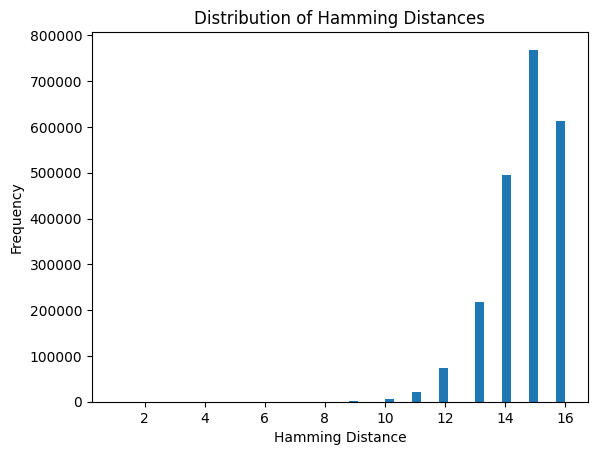

In [15]:
# Plot histogram of Hamming distances
plt.hist(distance_values, bins=50)
plt.title("Distribution of Hamming Distances")
plt.xlabel("Hamming Distance")
plt.ylabel("Frequency")
plt.show()


## Statistical Tests

Since we are working with images, we will not be able to calculate all the statistical tests that we would like to, but we will try to do them notwithstanding.

In [16]:
from scipy.stats import shapiro, wilcoxon, spearmanr, ttest_ind, normaltest

### Shapiro Test

In [17]:
def test_shapiro_normality(df, labels):
    normality_results = {}
    for label in labels:
        data = df[df['ClassLabel'] == label]['ImagePhash'].dropna().apply(lambda x: int(x, 16))
        normality_results[label] = shapiro(data)
    return normality_results

labels = df['ClassLabel'].unique()
shapiro_normality_results = test_shapiro_normality(df, labels)
shapiro_normality_results


c:\Users\Owner\.conda\envs\all4gpu\lib\site-packages\scipy\stats\_morestats.py:1816: UserWarning:

p-value may not be accurate for N > 5000.



{'algal leaf in tea': ShapiroResult(statistic=0.8173300623893738, pvalue=2.7590477499796112e-19),
 'anthracnose in tea': ShapiroResult(statistic=0.8895089626312256, pvalue=6.102106667182916e-14),
 'Apple Apple scab': ShapiroResult(statistic=0.8909381031990051, pvalue=0.0),
 'Apple Black rot': ShapiroResult(statistic=0.9112723469734192, pvalue=0.0),
 'Apple Cedar apple rust': ShapiroResult(statistic=0.9154989719390869, pvalue=4.534649900697628e-36),
 'Apple healthy': ShapiroResult(statistic=0.8538638353347778, pvalue=0.0),
 'Bacterial leaf blight in rice leaf': ShapiroResult(statistic=0.9011837840080261, pvalue=2.2570038993308117e-07),
 'bird eye spot in tea': ShapiroResult(statistic=0.9100658893585205, pvalue=2.0845152860771154e-12),
 'Blight in corn Leaf': ShapiroResult(statistic=0.9466022849082947, pvalue=1.2942070661343495e-33),
 'brown blight in tea': ShapiroResult(statistic=0.8248735070228577, pvalue=6.734480100354935e-19),
 'Brown spot in rice leaf': ShapiroResult(statistic=0.950

The Shapiro-Wilk test results for each class label in your dataset indicate whether the data follows a normal distribution. Here are the interpretations:

### Hypotheses:
- **Null Hypothesis (H0)**: The data follows a normal distribution.
- **Alternative Hypothesis (H1)**: The data does not follow a normal distribution.

### Interpretation:
- **Statistic**: A measure of the W statistic in the Shapiro-Wilk test.
- **P-value**: Indicates the probability of observing the test results under the null hypothesis.

### Conclusion:
- For all the class labels the p-values are significantly less than 0.05.
- This indicates that the null hypothesis is rejected for all class labels, meaning none of the data distributions for these labels follow a normal distribution.


### Spearman Correlation

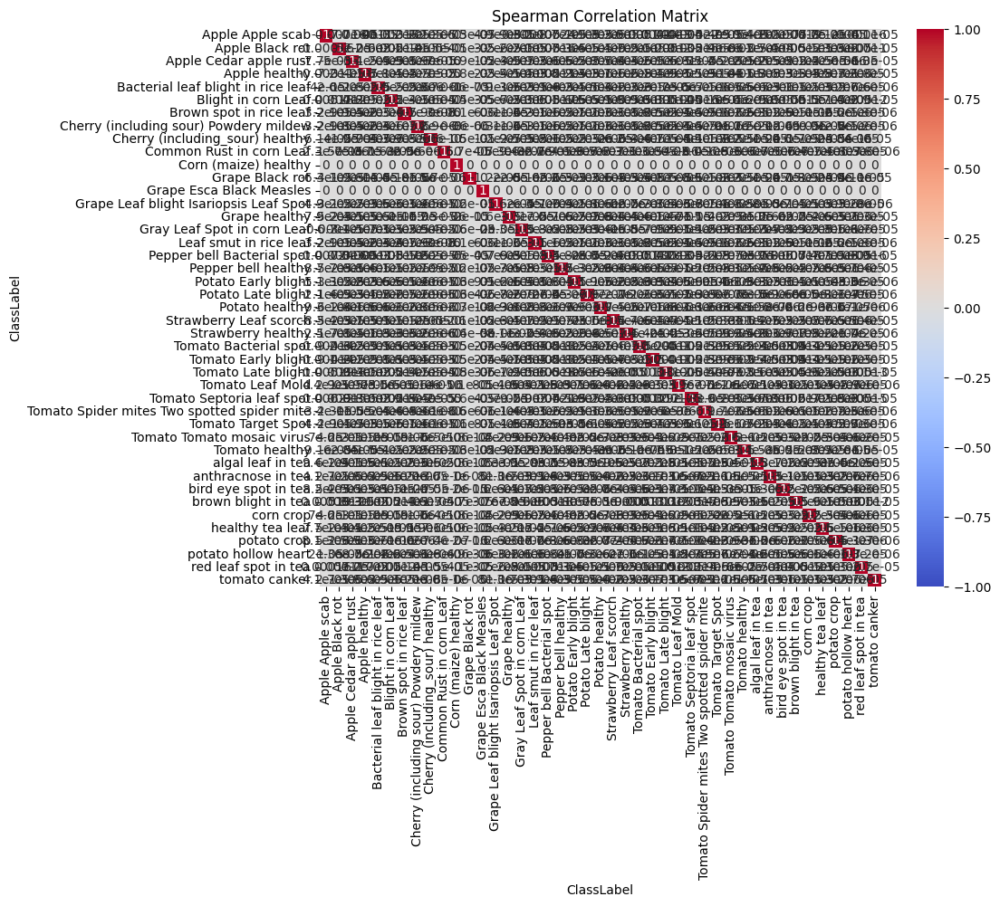

In [18]:
from scipy.stats import spearmanr
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Function to convert perceptual hash from hex to integer
def phash_to_int(phash):
    return int(phash, 16) if pd.notna(phash) else None

# Convert ImagePhash to integers
df['ImagePhashInt'] = df['ImagePhash'].apply(phash_to_int)

# Drop rows with NaN values in ImagePhashInt
df = df.dropna(subset=['ImagePhashInt'])

# Create a pivot table where rows are image names and columns are class labels with perceptual hash values
pivot_table = df.pivot_table(index='ImageName', columns='ClassLabel', values='ImagePhashInt', aggfunc='mean')

# Drop columns with all NaN values
pivot_table = pivot_table.dropna(axis=1, how='all')

# Fill missing values with the mean of each class label (optional)
pivot_table = pivot_table.fillna(pivot_table.mean())

# Calculate Spearman correlation for each pair of class labels
def calculate_spearman_correlation(pivot_table):
    correlation_matrix = pd.DataFrame(index=pivot_table.columns, columns=pivot_table.columns)
    for label1 in pivot_table.columns:
        for label2 in pivot_table.columns:
            if label1 != label2:
                correlation, _ = spearmanr(pivot_table[label1], pivot_table[label2], nan_policy='omit')
                correlation_matrix.loc[label1, label2] = correlation
            else:
                correlation_matrix.loc[label1, label2] = 1.0
    return correlation_matrix

spearman_correlation_matrix = calculate_spearman_correlation(pivot_table)

# Plot the Spearman correlation matrix
plt.figure(figsize=(10, 8))
sns.heatmap(spearman_correlation_matrix.astype(float), annot=True, cmap='coolwarm', vmin=-1, vmax=1)
plt.title('Spearman Correlation Matrix')
plt.show()


**Spearman Correlation:**

**Purpose**: To measure the strength and direction of association between two ranked variables.


**Results**: The Spearman correlation matrix showed very low correlation values, indicating that the perceptual hash values do not provide meaningful correlations between the different class labels.

### Perceptual Hash Distribution for each class

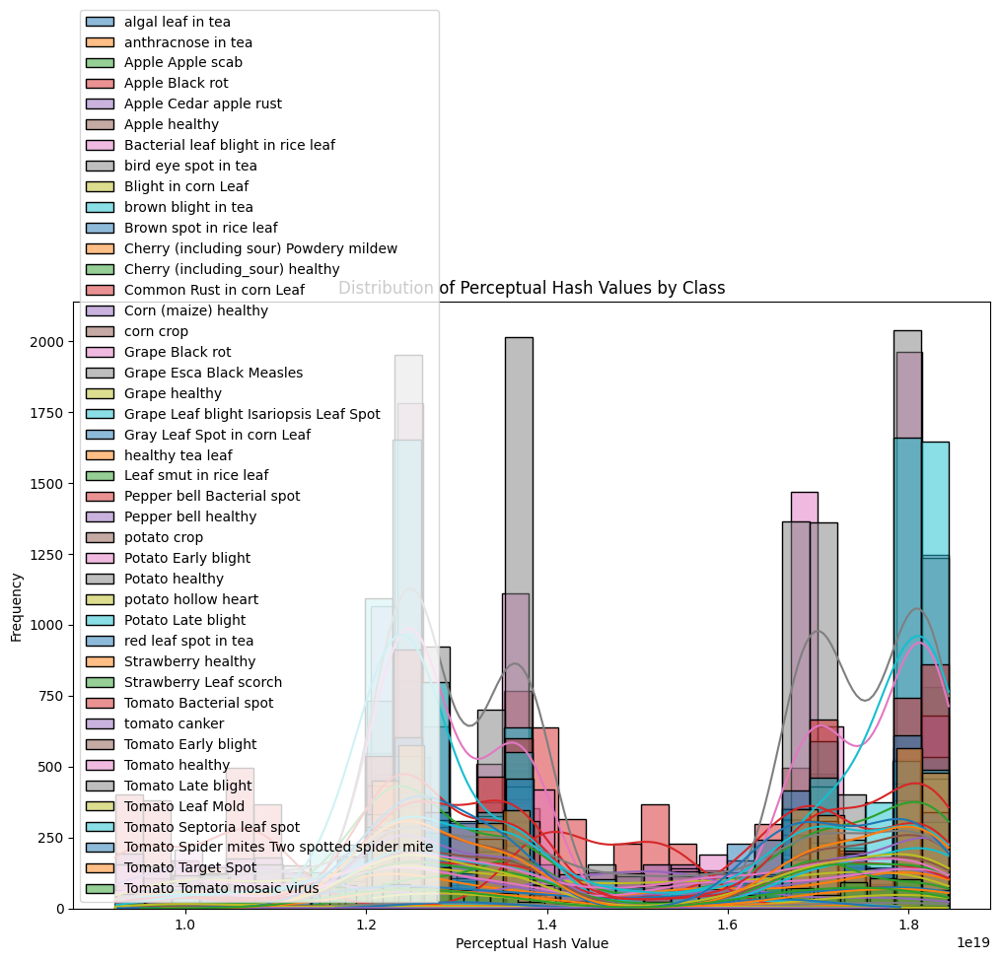

In [19]:
# Plot distribution of perceptual hash values for each class
plt.figure(figsize=(12, 8))
for label in df['ClassLabel'].unique():
    sns.histplot(df[df['ClassLabel'] == label]['ImagePhashInt'], bins=30, label=label, kde=True)

plt.title('Distribution of Perceptual Hash Values by Class')
plt.xlabel('Perceptual Hash Value')
plt.ylabel('Frequency')
plt.legend()
plt.show()


### Wilcoxon Test

In [20]:
from scipy.stats import wilcoxon
import pandas as pd

# Function to convert perceptual hash from hex to integer
def phash_to_int(phash):
    return int(phash, 16) if pd.notna(phash) else None

# Convert ImagePhash to integers
df['ImagePhashInt'] = df['ImagePhash'].apply(phash_to_int)

# Drop rows with NaN values in ImagePhashInt
df = df.dropna(subset=['ImagePhashInt'])

# Prepare the DataFrame for Wilcoxon test
pivot_table = df.pivot_table(index='ImageName', columns='ClassLabel', values='ImagePhashInt', aggfunc='mean')

# Drop columns with all NaN values
pivot_table = pivot_table.dropna(axis=1, how='all')

# Fill missing values with the mean of each class label (optional)
pivot_table = pivot_table.fillna(pivot_table.mean())

# Perform Wilcoxon test for each pair of labels
def perform_wilcoxon_test(pivot_table):
    labels = pivot_table.columns
    wilcoxon_results = {}
    for i, label1 in enumerate(labels):
        for label2 in labels[i+1:]:
            if label1 != label2:
                # Ensure samples are paired and have the same length
                valid_idx = pivot_table[[label1, label2]].dropna().index
                if len(valid_idx) > 0:
                    stat, p_value = wilcoxon(pivot_table.loc[valid_idx, label1], pivot_table.loc[valid_idx, label2])
                    wilcoxon_results[(label1, label2)] = (stat, p_value)
    return wilcoxon_results

wilcoxon_results = perform_wilcoxon_test(pivot_table)
wilcoxon_results


{('Apple Apple scab', 'Apple Black rot'): (716473508.0, 0.0),
 ('Apple Apple scab', 'Apple Cedar apple rust'): (534435823.0, 0.0),
 ('Apple Apple scab', 'Apple healthy'): (587423298.0, 0.0),
 ('Apple Apple scab', 'Bacterial leaf blight in rice leaf'): (51089523.0, 0.0),
 ('Apple Apple scab', 'Blight in corn Leaf'): (426245454.0, 0.0),
 ('Apple Apple scab', 'Brown spot in rice leaf'): (283462768.0, 0.0),
 ('Apple Apple scab', 'Cherry (including sour) Powdery mildew'): (534487961.0,
  0.0),
 ('Apple Apple scab', 'Cherry (including_sour) healthy'): (463257744.0, 0.0),
 ('Apple Apple scab', 'Common Rust in corn Leaf'): (30376882.0, 0.0),
 ('Apple Apple scab', 'Corn (maize) healthy'): (77985210.0, 0.0),
 ('Apple Apple scab', 'Grape Black rot'): (987205378.0, 0.0),
 ('Apple Apple scab', 'Grape Esca Black Measles'): (1083157528.0, 0.0),
 ('Apple Apple scab', 'Grape Leaf blight Isariopsis Leaf Spot'): (940095875.0,
  0.0),
 ('Apple Apple scab', 'Grape healthy'): (401745653.0, 0.0),
 ('Apple Ap

**Wilcoxon Test:**

**Purpose:** To compare two paired samples to assess whether their population mean ranks differ.

**Results:**
The Wilcoxon test was performed for each pair of class labels.
Most of the p-values are significantly low, indicating that the samples are different (rejecting the null hypothesis).
This means that the perceptual hash values between different class labels show significant differences.

Wilcoxon Test between algal leaf in tea and anthracnose in tea
Statistics=0.000, p=0.000
Samples are different (reject H0)


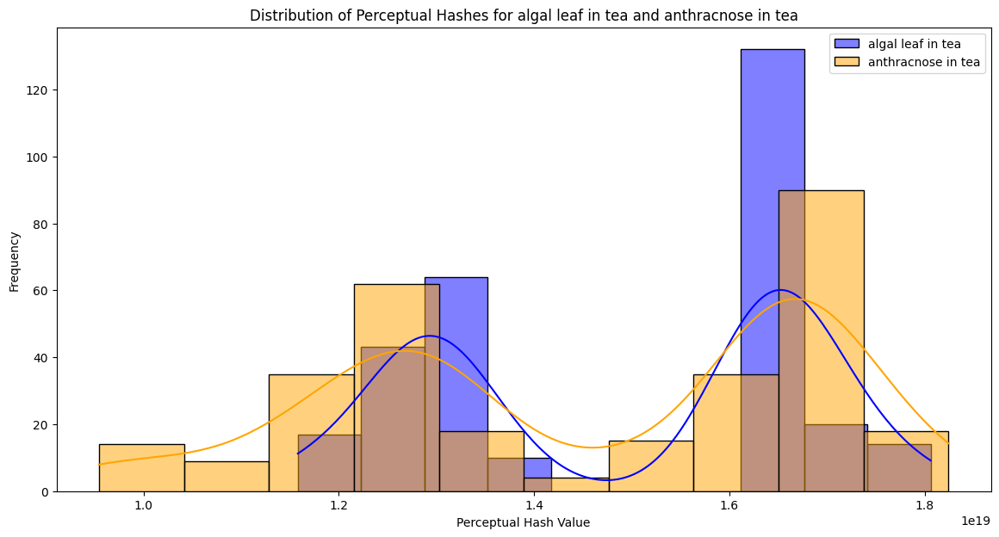

In [21]:
class1_name = df['ClassLabel'].unique()[0]
class2_name = df['ClassLabel'].unique()[1]

class1_hashes = df[df['ClassLabel'] == class1_name]['ImagePhash'].dropna().apply(lambda x: int(x, 16))
class2_hashes = df[df['ClassLabel'] == class2_name]['ImagePhash'].dropna().apply(lambda x: int(x, 16))

# Ensure sample sizes are the same and manageable
min_length = min(len(class1_hashes), len(class2_hashes), 5000)
class1_hashes = class1_hashes.sample(min_length, random_state=42)
class2_hashes = class2_hashes.sample(min_length, random_state=42)

if class1_hashes.nunique() == 1 or class2_hashes.nunique() == 1:
    print('Cannot perform Wilcoxon test: one of the input arrays is constant.')
else:
    stat, p = wilcoxon(class1_hashes, class2_hashes)
    print(f'Wilcoxon Test between {class1_name} and {class2_name}')
    print('Statistics=%.3f, p=%.3f' % (stat, p))
    if p > 0.05:
        print('Samples are similar (fail to reject H0)')
    else:
        print('Samples are different (reject H0)')

    # Visualize the distribution of perceptual hashes
    plt.figure(figsize=(14, 7))
    sns.histplot(class1_hashes, color='blue', kde=True, label=class1_name)
    sns.histplot(class2_hashes, color='orange', kde=True, label=class2_name)
    plt.title(f'Distribution of Perceptual Hashes for {class1_name} and {class2_name}')
    plt.xlabel('Perceptual Hash Value')
    plt.ylabel('Frequency')
    plt.legend()
    plt.show()

### T-Test

In [22]:
min_length = min(len(class1_hashes), len(class2_hashes), 5000)
class1_hashes = class1_hashes.sample(min_length, random_state=42)
class2_hashes = class2_hashes.sample(min_length, random_state=42)

stat, p = ttest_ind(class1_hashes, class2_hashes)
print('T-test between two classes')
print('Statistics=%.3f, p=%.3f' % (stat, p))
if p > 0.05:
    print('Samples have same mean (fail to reject H0)')
else:
    print('Samples have different mean (reject H0)')

T-test between two classes
Statistics=2.262, p=0.024
Samples have different mean (reject H0)


# Conclusion

The analysis of the perceptual hash values has provided valuable insights into the dataset's characteristics. The significant differences between class labels observed through the Wilcoxon test suggest that these labels have distinct features, even though these differences are not captured linearly by the perceptual hash values. This underscores the need for exploring alternative features and more advanced modeling techniques to improve class differentiation.

These findings are crucial for our project's goal of accurately identifying and categorizing different classes. By understanding that each class has distinct characteristics, we can tailor our detection models more precisely, enhancing their accuracy and reliability. This will ultimately enable us to develop robust machine learning models that can effectively address the project's objectives, leading to better outcomes and more informed decision-making.

Apple Apple scab


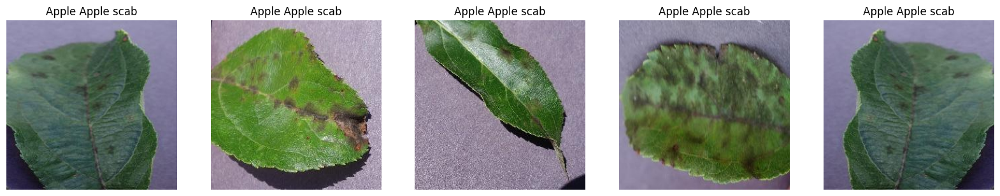

Apple Black rot


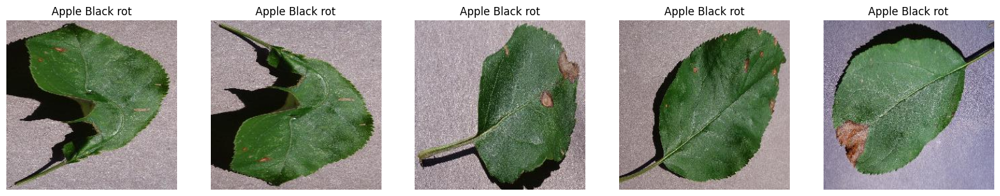

Apple Cedar apple rust


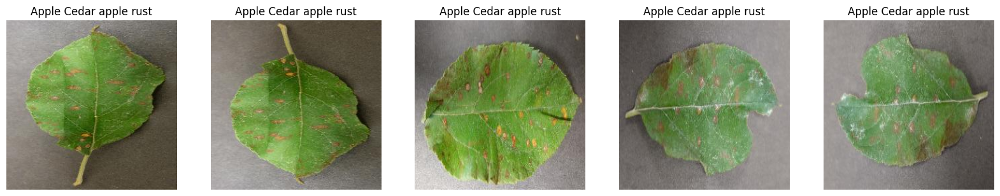

Apple healthy


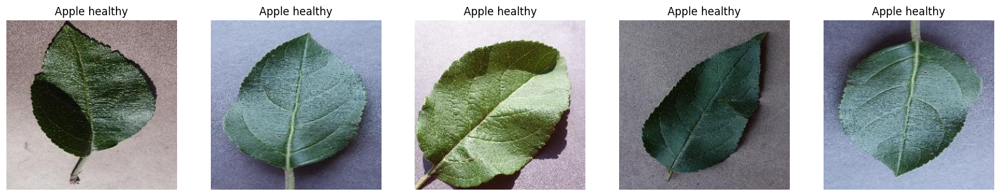

Bacterial leaf blight in rice leaf


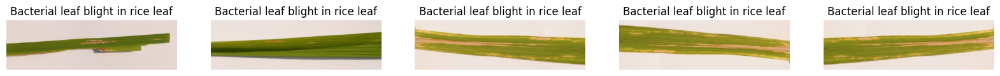

Blight in corn Leaf


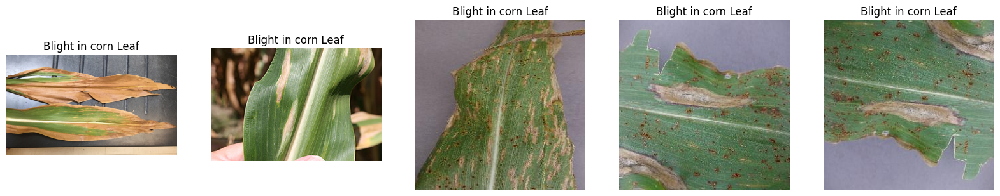

Brown spot in rice leaf


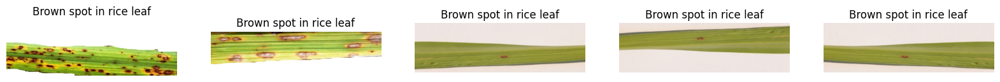

Cherry (including sour) Powdery mildew


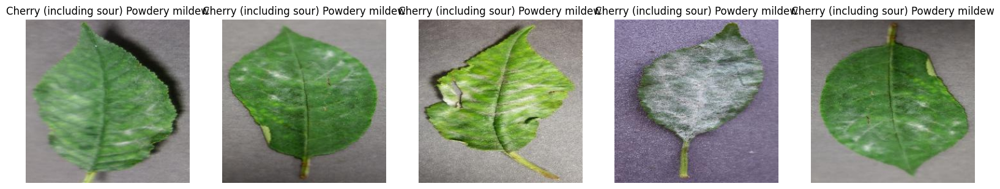

Cherry (including_sour) healthy


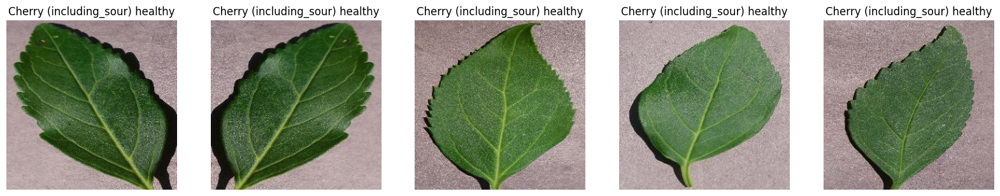

Common Rust in corn Leaf


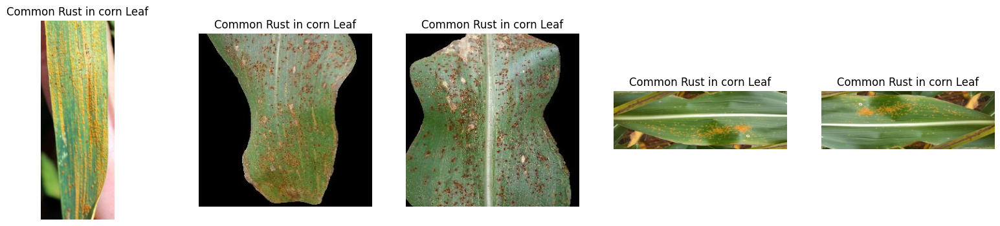

Corn (maize) healthy


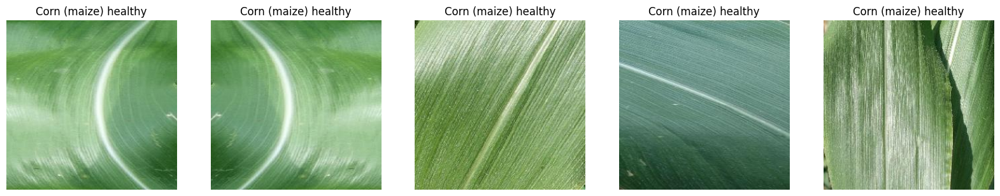

Grape Black rot


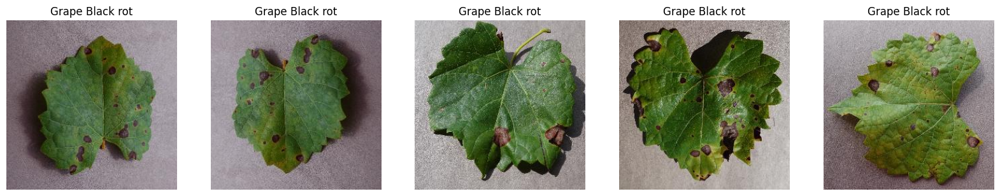

Grape Esca Black Measles


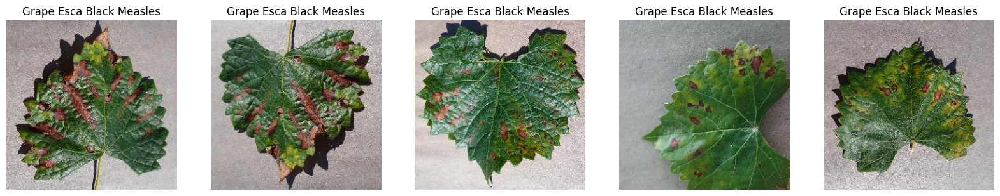

Grape Leaf blight Isariopsis Leaf Spot


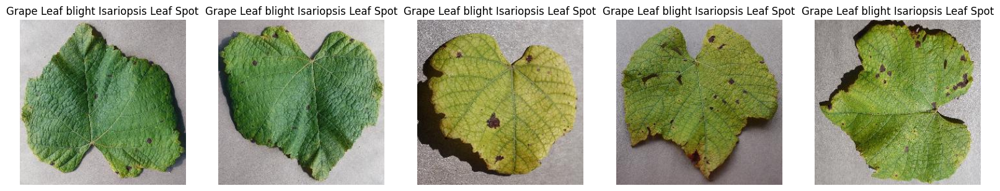

Grape healthy


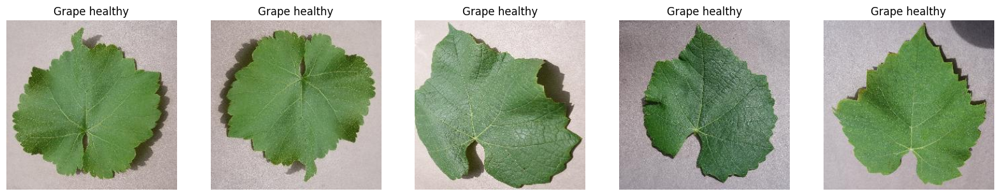

Gray Leaf Spot in corn Leaf


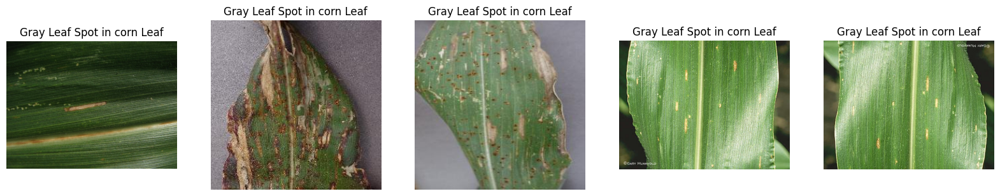

Leaf smut in rice leaf


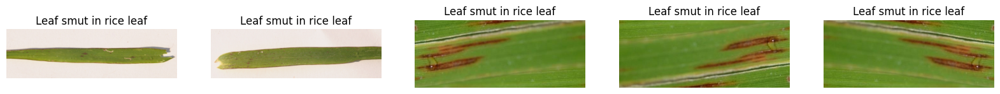

Pepper bell Bacterial spot


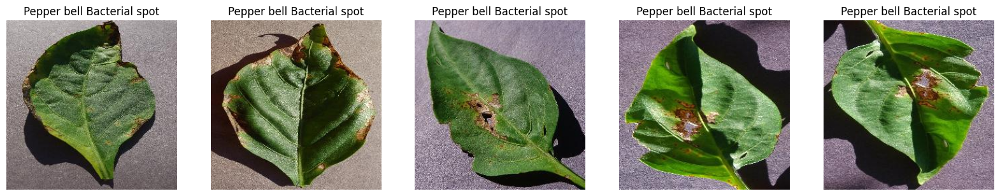

Pepper bell healthy


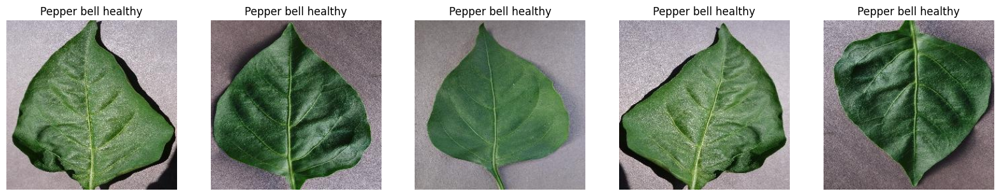

Potato Early blight


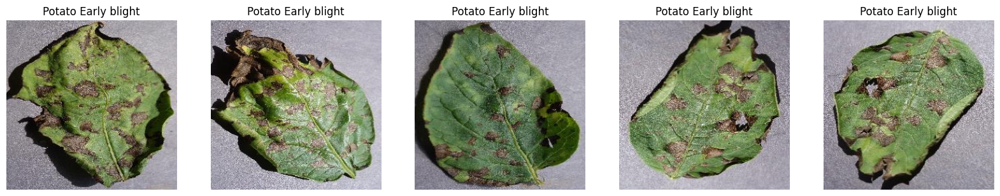

Potato Late blight


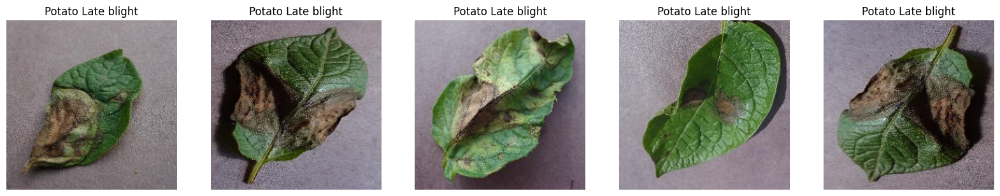

Potato healthy


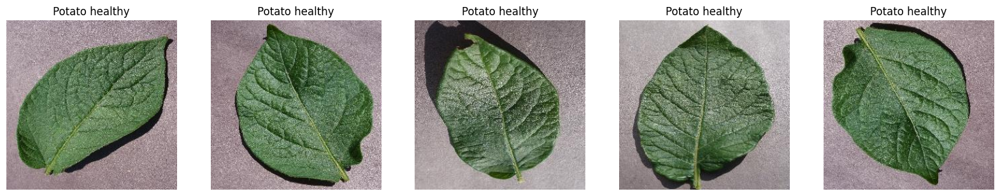

Strawberry Leaf scorch


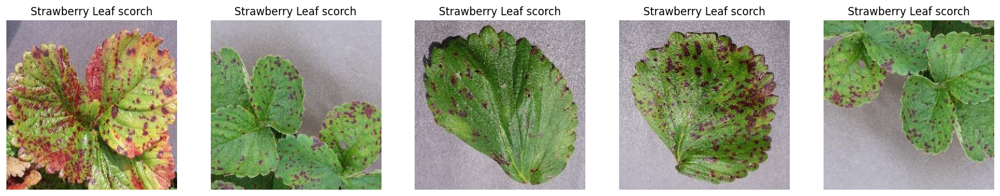

Strawberry healthy


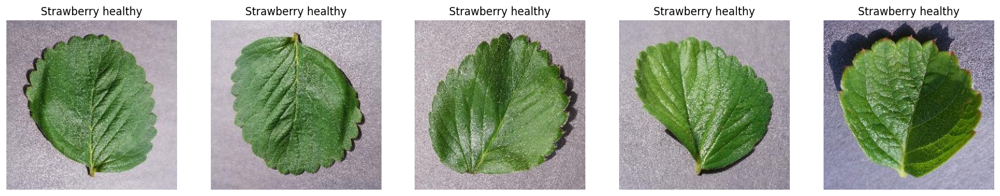

Tomato Bacterial spot


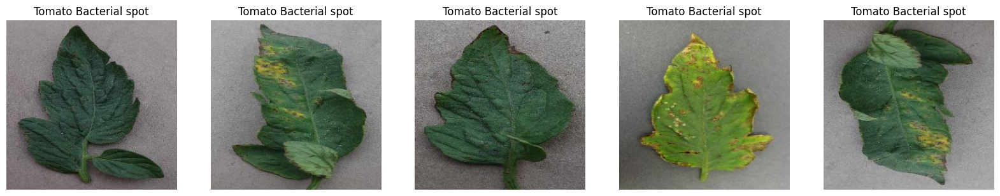

Tomato Early blight


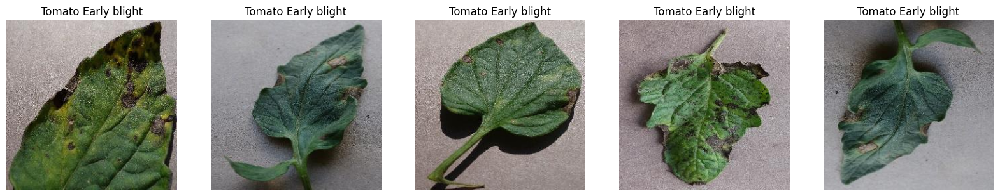

Tomato Late blight


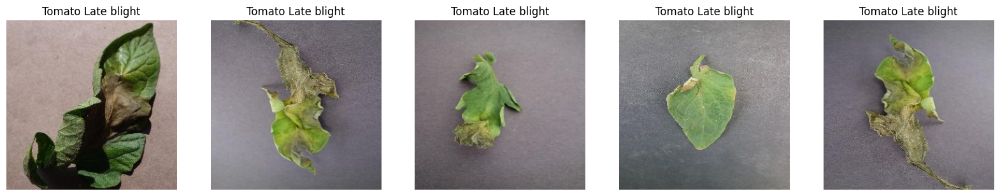

Tomato Leaf Mold


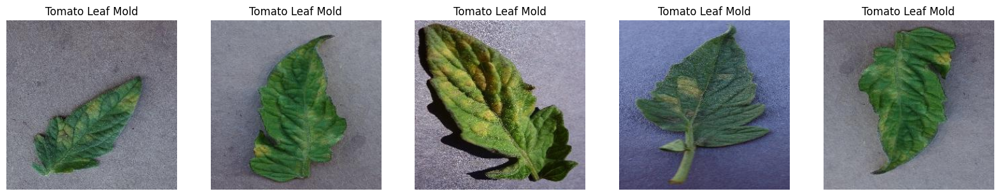

Tomato Septoria leaf spot


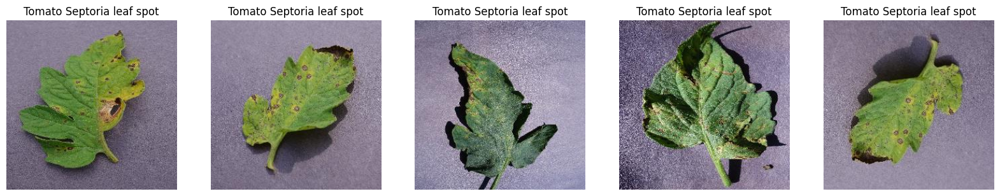

Tomato Spider mites Two spotted spider mite


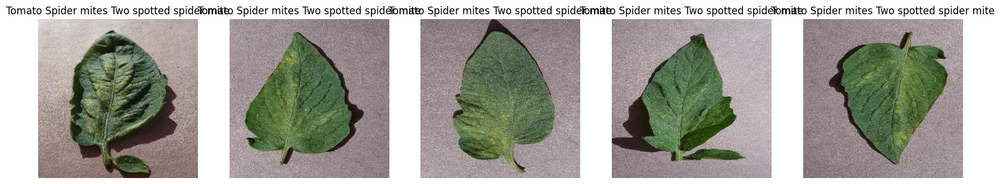

Tomato Target Spot


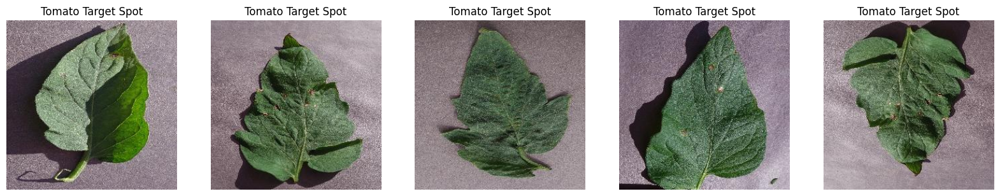

Tomato Tomato mosaic virus


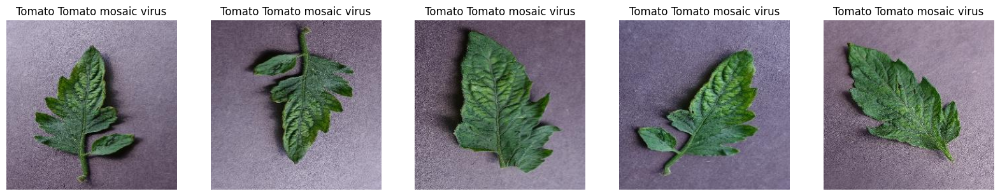

Tomato healthy


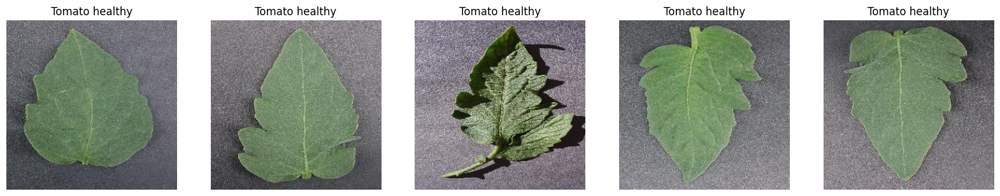

algal leaf in tea


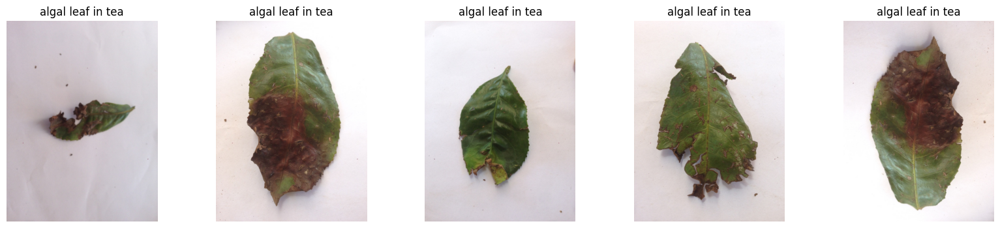

anthracnose in tea


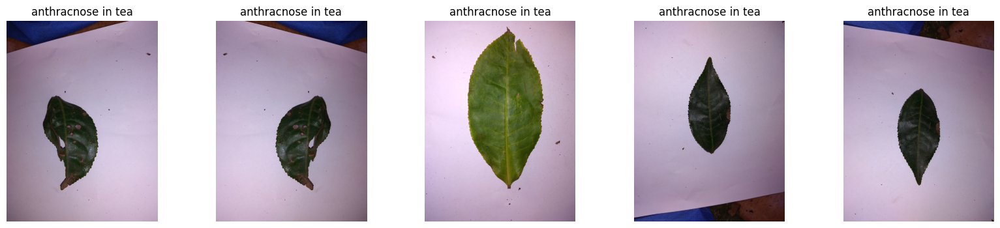

bird eye spot in tea


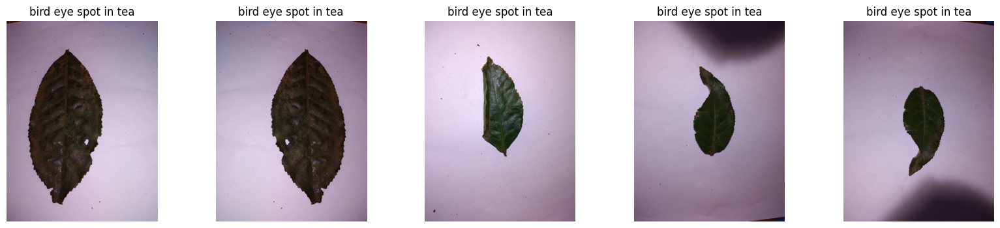

brown blight in tea


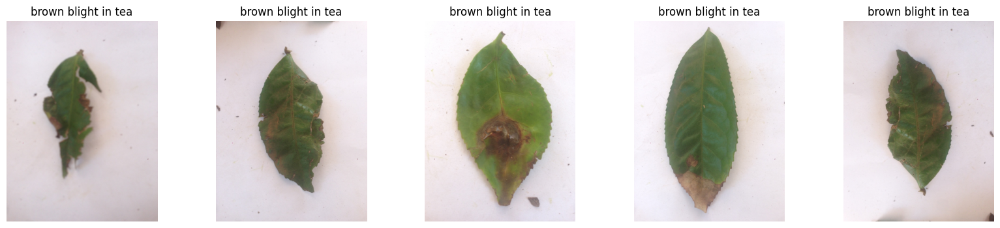

corn crop


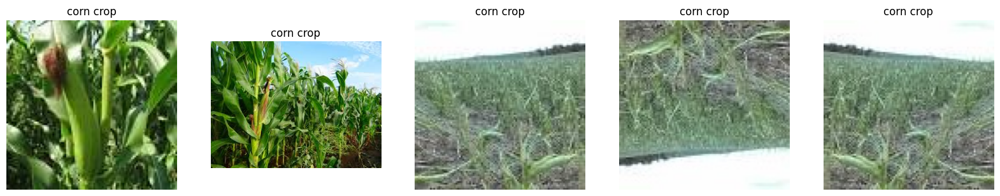

healthy tea leaf


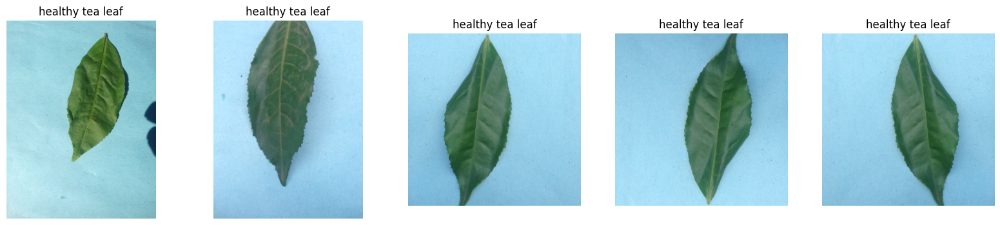

potato crop


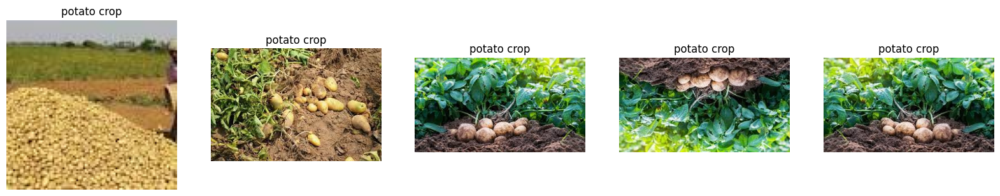

potato hollow heart


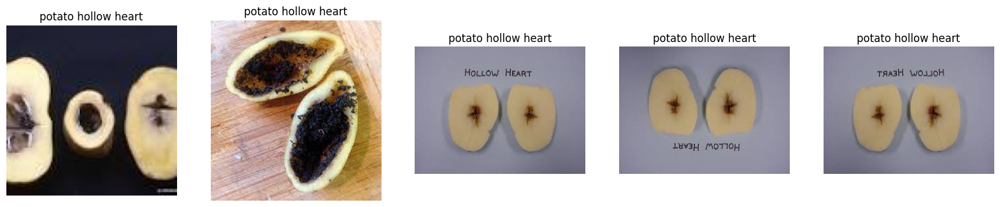

red leaf spot in tea


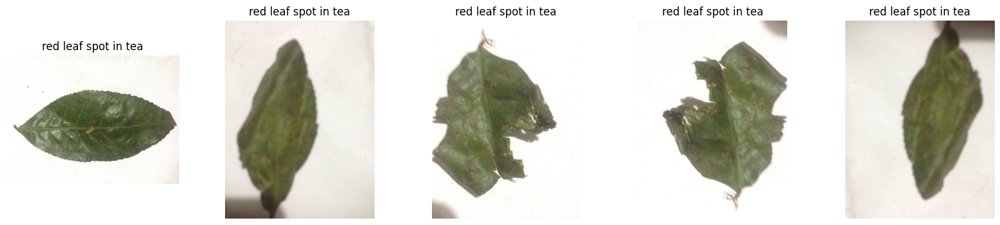

tomato canker


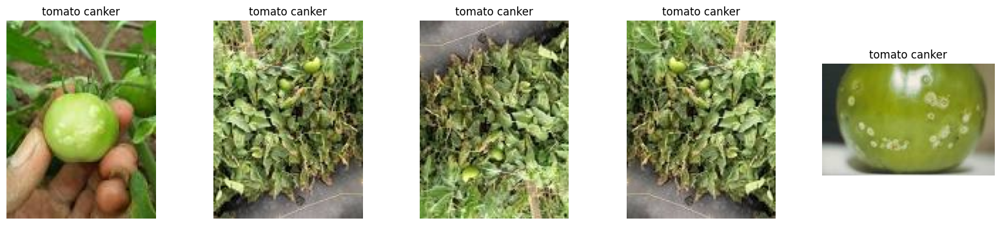

In [23]:
import matplotlib.pyplot as plt
from PIL import Image

grouped = df.groupby('ClassLabel')

# Plot the first 5 images for each class
for label, group in grouped:
    print(label)
    print('=====================')
    
    # Create a figure with 5 subplots (1 row, 5 columns)
    fig, axes = plt.subplots(1, 5, figsize=(20, 4))
    
    # Iterate over the first 5 rows of the group
    for i in range(min(5, len(group))):  # This ensures we don't go out of bounds if there are less than 5 images
        img_path = group['ImagePath'].iloc[i]
        img = Image.open(img_path)
        
        # Plot the image in the i-th subplot
        axes[i].imshow(img)
        axes[i].set_title(label)
        axes[i].axis('off')
    
    # Hide any unused subplots if the group has less than 5 images
    if len(group) < 5:
        for j in range(len(group), 5):
            axes[j].axis('off')
    
    plt.show()
